#Airports and Seaports Dashboard

##Introduction

Transportation plays a crucial role in every sphere of human life, with Air and Sea travel revolutionizing the development of modern world. Airports and Seaports work as gate-keepers for global connectivity, radically improving the quality of life in economic, social and healthcare spheres. For this Assignment, I choose to map these pivotal elements of the world, to understand them with respect to each country and explore them visually on the map. Understanding the distribution across the countries and regions can play an important role in real world implementation of tourism and trade. 

In [61]:
import folium
from folium.plugins import MarkerCluster, Fullscreen, MeasureControl, MousePosition, MiniMap
from folium import plugins
from branca.element import Figure
import geojson
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import panel as pn
import plotly.express as px
import matplotlib.pyplot as plt
import contextily as ctx
import numpy as np
from bokeh.resources import INLINE

In [62]:
airport_data = gpd.read_file("airports_world.geojson")
airport_data = airport_data.dropna(subset=['Country_Name'])

seaport_data = gpd.read_file("ports_world.geojson")
seaport_data = seaport_data.dropna(subset=['Country_Name'])


##Dataset and Data Cleaning:

The data set for world Airports and Seaports was downloaded online and involved an extensive process of cleaning the fields and values to obtain the required data in a geojson format. 
For the Airports dataset, data cleaning and preprocessing involved discarding the fields not required and creating a new field of Country_Name for the corresponding Country Code. To achieve this, I used a different dataset with Country code and corresponding Name to create a lookup and generate the final geojson file [airports_world.geojson] imported in this. The same process was repeated for the Seaports dataset to generate the final geojson file [ports_world.geojson] used in the assignment.


In [63]:
print(airport_data.columns)

Index(['code', 'time_zone_id', 'name', 'country_id', 'Country_Name',
       'geometry'],
      dtype='object')


In [64]:
print(seaport_data.columns)

Index(['PORT_NAME', 'COUNTRY', 'LATITUDE', 'LONGITUDE', 'GlobalID',
       'Country_Name', 'geometry'],
      dtype='object')


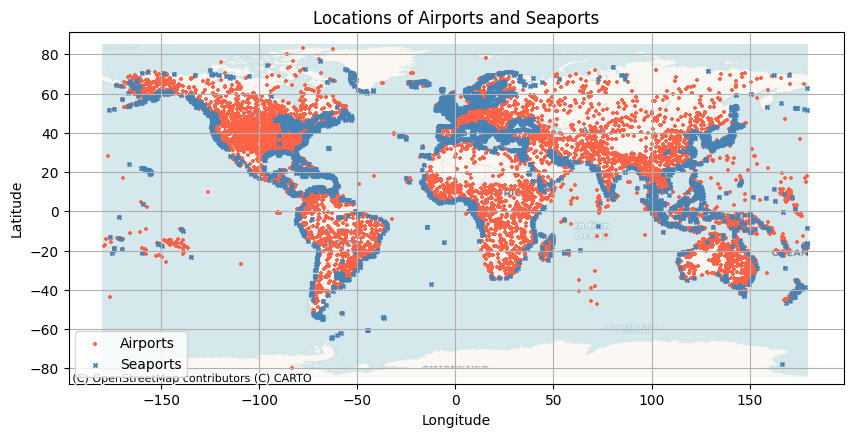

In [65]:
# Extract latitude and longitude data for airports and seaports
airport_latitudes = airport_data['geometry'].y
airport_longitudes = airport_data['geometry'].x

seaport_latitudes = seaport_data['LATITUDE']
seaport_longitudes = seaport_data['LONGITUDE']

# Create the scatter plot
plt.figure(figsize=(10, 6))

# Plot airports and seaports
plt.scatter(airport_longitudes, airport_latitudes, color='#FF6347', label='Airports',  marker='+', s=8)
plt.scatter(seaport_longitudes, seaport_latitudes, color='#4682B4', label='Seaports',marker='x', s=8)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Locations of Airports and Seaports')
plt.legend()
plt.grid(True)

# Get current axes
ax = plt.gca()

# Overlay base map
source = ctx.providers.CartoDB.Voyager
ctx.add_basemap(ax, crs='EPSG:4326', source=source)

plt.show()


##Static Map:

A simple static map with a scatter plot is created to understand the distribution of the Airports and Seaports across the world. This map gives us insight on the general location and clustering of Airports and Seaports for the countries. We can observe that the countries along the coastline and access to Waterways have higher number of Seaports and Countries located in central mainland have only Airports and very few Seaports. This data can give the observer an overview understanding of the main mode of transportation for the countries. 


In [66]:
#Function to display the Airport Name
def popup_aiports(row):
    html = "<h4>{}</h4>".format(row['name'])
    html += "<p>Country: {}</p>".format(row['Country_Name'])
    return html

#Function to display the Seaport Name
def popup_seaports(row):
    html = "<h4>{}</h4>".format(row['PORT_NAME'])
    html += "<p>Country: {}</p>".format(row['Country_Name'])
    return html

In [67]:
#Interactive map 
Europe = (50, 10)

# Create the map object with a specific tile layer
map = folium.Map(location=Europe, zoom_start=5)

#Mapbox 
mapbox_user = 'phalguni-venkatesh'
style_id1 = 'clvo47yaw00dm01qu6298exo2'  
mapbox_token = ''

# Add multiple tile layers to the map
tiles1 = 'https://api.mapbox.com/styles/v1/'+mapbox_user+'/'+style_id1+'/tiles/256/{z}/{x}/{y}?access_token=pk.eyJ1IjoicGhhbGd1bmktdmVua2F0ZXNoIiwiYSI6ImNsc3ZxYzAzZTFrZnIybHFrdHp1dGlrMmUifQ.ukhr8m9vHBV7n_xJXWFTMA'+mapbox_token
folium.TileLayer('cartodbpositron').add_to(map)
folium.TileLayer('openstreetmap').add_to(map)
folium.TileLayer(tiles1, name='Custom Mapbox Layer', attr='Mapbox').add_to(map)  # Set custom name and attribution


# Adding markers and other features
marker_cluster = MarkerCluster().add_to(map)
Fullscreen().add_to(map)
plugins.Geocoder().add_to(map)
folium.LayerControl().add_to(map)
MeasureControl().add_to(map)
MousePosition().add_to(map)
MiniMap(tile_layer="OpenStreetMap").add_to(map)



##Features included in Interactive map

Below are some of the additional features included in the map to be more user-friendly:

- **Marker cluster:** This allows better readability with large data, especially when dealing with vast number of markers plotted across the world.
- **Fullscreen:** This makes it easier for the User to read and interact with the map by enabling Full screen mode.
- **Measure control:** This enhances the interactivity with the map, allowing user to measure the linear distance and area over the selected points/region. This can allow the user to analyse the distance between the markers, like the closest Airport to a specific Seaport.
- **Mouse position:** This feature displays the geolocation (latitude and longitude) of the movement of the cursor on the map.
- **Mini map:** This creates miniature map embedded providing the user with the over view of the map and allowing the user to interact with the Main map as well. This functionality can help when data markers are plotted across an enormous region, like all countries of the world.
- **Geo coder:** This is a simple feature of allowing the user to look for a specific location in the search box and hence make finding specific Airport/Seaport easier for the user.

In [68]:
#Add folium markers for airports
for index, row in airport_data.iterrows():
    popup_content = popup_aiports(row)
    folium.Marker(location=[row.geometry.y, row.geometry.x], popup=popup_content,icon=folium.Icon(color="red", icon="circle", prefix='fa')).add_to(marker_cluster)

#Add folium markers for seaports
for index, row in seaport_data.iterrows():
    popup_content = popup_seaports(row)
    folium.Marker(location=[row.geometry.y, row.geometry.x], popup=popup_content,icon=folium.Icon(color="blue", icon="circle", prefix='fa')).add_to(marker_cluster)

map

##Interactive Map:

The Airports and Seaports of the world are plotted on the interactive Map for the user to explore the Data with the simulating features included in the map for higher intractability. Function to display the Name and Country of the Markers is added to make the map more visually appealing and informative. The map includes different tile set (base map) layered for the user to choose the preferred one to analyse the data. This is implemented using Layer control over the map and one of the custom tiles is created and imported using Mapbox Studio. The base map options opted here are simple and would appeal to majority. 


In [69]:
# Countries in Asia
asian_countries = ['Afghanistan', 'Armenia', 'Azerbaijan', 'Bahrain', 'Bangladesh', 'Bhutan', 'Brunei Darussalam', 'Cambodia', 'China', 'Georgia', 'India', 'Indonesia', 'Iran, Islamic Republic of', 'Iraq', 'Israel', 'Japan', 'Jordan', 'Kazakhstan', 'Kuwait', 'Kyrgyzstan', "Lao People's Democratic Republic", 'Lebanon', 'Malaysia', 'Maldives', 'Mongolia', 'Myanmar', 'Nepal', 'Oman', 'Pakistan', 'Palestine, State of', 'Philippines', 'Qatar', 'Saudi Arabia', 'Singapore', 'Korea, Republic of', 'Sri Lanka', 'Syrian Arab Republic', 'Taiwan, Province of China', 'Tajikistan', 'Thailand', 'Timor-Leste', 'Turkey', 'Turkmenistan', 'United Arab Emirates', 'Uzbekistan', 'Viet Nam', 'Yemen']

# Convert the list to set for faster lookup
asian_countries_set = set(asian_countries)

# Filter the airports for countries in Asia
asian_airports = airport_data[airport_data['Country_Name'].isin(asian_countries_set)]
print(len(asian_airports))

#Filter the seaports for countries in Asia
asian_seaports = seaport_data[seaport_data['Country_Name'].isin(asian_countries_set)]
print(len(asian_seaports))


1744
756


##Dashboard:

Due to the immensity of the data, creating an interactive dashboard for the Airports and Seaports of all the countries proved to be difficult as I faced issues with memory allocation. Hence, I opted to filter the data for Asia, which covers a large geographical area and consisting of significant number of Airports and Seaports.   Both the dataset of Airports and Seaports was filtered for the list of countries in Asia to be mapped. 


In [70]:
pn.extension() 

#Create the widgets 
country_selector = pn.widgets.Select(options=asian_countries, name='Select Country')
data_selector = pn.widgets.RadioBoxGroup(name='Data Markers', options=['Airports', 'Seaports', 'Airports & Seaports'])

The dashboard includes widgets for Country selection drop-down, which allows the user to select the country for which the markers are to be mapped. These include the list of countries in the Asian continent and all the Airports or Seaports are plotted based on the selection. The user can also choose to view Airports, Seaports or both for the country selected using the Radio button widget. This option allows flexibility for the user to choose either or both options to view the data and regardless of the option, the map will contain markers. 

In [71]:

#Function to create the folium map with the filtered dataa
def create_foliumMap(data,ports_data):

    if data is not None:
        centroid = data.iloc[0].geometry.centroid
        latitude = centroid.y
        longitude = centroid.x
        center = (latitude, longitude)  #Center to create the map
        
    elif ports_data is not None:
        centroid = ports_data.iloc[0].geometry.centroid
        latitude = centroid.y
        longitude = centroid.x
        center = (latitude, longitude)  #Center to create the map
        
    else:
        center = (35, 105)    #Default value
    

    folium_map = folium.Map(location=center, tiles="OpenStreetMap", zoom_start=6,width=800, height=600)
       

    # Markers and features for the map
    marker_cluster = MarkerCluster().add_to(folium_map)
    Fullscreen().add_to(folium_map)
    plugins.Geocoder().add_to(folium_map)
    MeasureControl().add_to(folium_map)
    MousePosition().add_to(folium_map)
    MiniMap(tile_layer="OpenStreetMap").add_to(folium_map)
    

    # Add  marker if the value is present
    if data is not None:
        for index, row in data.iterrows():
            popup_content = popup_aiports(row)
            folium.Marker(location=[row.geometry.y, row.geometry.x], 
                          popup=popup_content, icon=folium.Icon(color="red", icon="circle", prefix='fa')).add_to(marker_cluster)
   
    # Add  marker if the value is present
    if ports_data is not None:
        for index, row in ports_data.iterrows():
            popup_content = popup_seaports(row)
            folium.Marker(location=[row.geometry.y, row.geometry.x], 
                          popup=popup_content,icon=folium.Icon(color="blue", icon="circle", prefix='fa')).add_to(marker_cluster)

    #Return the map created
    return folium_map

In [72]:
#Function to update the map based on the event triggered i.e country selected
def update_map_country(asian_airports, asian_seaports, country, width, height, selected_markers):
    data = asian_airports[asian_airports['Country_Name'] == country].copy()
    seaports_data = asian_seaports[asian_seaports['Country_Name'] == country].copy()
    
    # Filter the data based on selected markers
    if 'Both' not in selected_markers:
        if 'Airports' not in selected_markers:
            data = None  # No filtering for airports
        if 'Seaports' not in selected_markers:
            seaports_data = None  # No filtering for seaports
    
    html_content = create_foliumMap(data, seaports_data)
    return pn.pane.HTML(html_content, width=width, height=height)

The dashboard is created using 2 functions, to create the map for the selected country and updating the map for the country. The final interactive map generated is assembled with the widgets to create the final Dashboard that allows the user to interact with the data by filtering the data and choosing the country. In the dashboard, when the user chooses a specific country and filters based on the data, if there are no markers available for that category, the map will remain the same until a new value is choose, as in the example for the country Afghanistan, there are no Seaports present and hence would not be mapped. This can occur as some of the countries in Asia are landlocked and do not have Seaports. 

In [73]:
width = 1000
height = 800

# Bind the function with widgets
map_pane = pn.bind(update_map_country, asian_airports, asian_seaports, country_selector.param.value,selected_markers=data_selector.param.value,  width=width, height=height)

# Layout the dashboard including the dropdown and multi-select
dashboard = pn.Column(
    '# Aiports and Seaports in Asia Dashboard',
    pn.Row(country_selector),
    pn.Row(data_selector),
    map_pane
)

In [74]:
dashboard.save('Dashboard_for_Asia.html', embed=True, resources=INLINE)


##Final Dashboard:

The Dashboard produced has all the features included in the previous Interactive map, allowing for enhanced readability and ease of intractability with the data. The data can be filtered and analyzed by the user using the dashboard


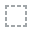
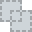
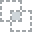
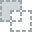
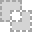
...
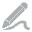
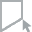
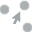
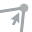
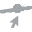

In [75]:
from IPython.display import HTML

with open('Dashboard_for_Asia.html', 'r') as file:
    html_content = file.read()

# Display the HTML content in the notebook
HTML(html_content)

###Reference:

- Airport Dataset: https://data.opendatasoft.com/explore/dataset/osm-world-airports%40babel/export/
- Seaport Dataset: https://data.harvestportal.org/dataset/world-ports-index/resource/32f52965-1ae1-47a0-b1ad-45d1bf64093b?inner_span=True